# Post-scVI analysis of donor P13 data: SN+multiome; only invading trophoblast states; cleanup v3 (after v2 in S6-2)

After CCG and doublets removal (both by genotype and GEX)

This the version of the manifold after running scVI by `sample`

11.2021

What happens here:
- load preprocessed object (raw filtered counts)
- do normalising & log transforming
- save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- calculate neighborhood graph on the latent dimensionality reporesentation from scVI
- umap
- unbiased clustering
- save

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import anndata
import bbknn
import scrublet as scr
import os
import sklearn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

In [2]:
np.random.seed(0)

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.5
scanpy      1.7.1
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.5
annoy               NA
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
bbknn               NA
brotli              NA
cairo               1.20.0
certifi             2020.12.05
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.03.1
dateutil            2.8.1
decorator           4.4.2
fsspec              0.8.7
get_version         2.1
google              NA
h5py                3.1.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyte

In [5]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202007_snRNA-seq_MFI/snRNA_seq_MFI_202007_adatas/202012_FINAL_reanalysis_with_souporcell_deconvolution_common_variants/donor_P13_all_samples_analysis_202110/'

## Reading the preprocessed object

Preprocessing happened in S0 notebook

In [5]:
# reading the raw filtered object from joint analysis
adata = sc.read(save_path + 'adata_raw_filtered.h5ad')

In [6]:
# reading IDs of final cells to keep after doublet exclusion (scrublet and souporcell)
nodoublet_nulcei_IDs = pd.read_csv(save_path + 'obs_table_nodoublets.csv', index_col=0)
nodoublet_nulcei_IDs

,n_genes,donor,tissue_block,age,sample,percent_mito,n_counts,dataset,technique,scrublet_score,...,barcode,souporcell_assignment,inter_ind_doublet,S_score,G2M_score,phase,annotation_prev,louvain,is_doublet_propagate,origin_M_F
barcode_sample,,,,,,,,,,,,,,,,,,,,,
AAACCCAAGATACATG-1_WSSS_PLA8764121,1253,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000000,1820.0,snRNA-seq,10X,0.191617,...,AAACCCAAGATACATG-1_WSSS_PLA8764121,WSSS_PLA8764121_0,0,0.053412,0.056947,G2M,0_none,16,0,F
AAACCCACAAATCCCA-1_WSSS_PLA8764121,1279,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000535,1868.0,snRNA-seq,10X,0.032895,...,AAACCCACAAATCCCA-1_WSSS_PLA8764121,WSSS_PLA8764121_1,0,-0.120729,-0.113529,G1,dM2,10,0,M
AAACCCACAACTGTGT-1_WSSS_PLA8764121,473,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000000,556.0,snRNA-seq,10X,0.091892,...,AAACCCACAACTGTGT-1_WSSS_PLA8764121,WSSS_PLA8764121_1,0,0.042173,-0.027934,S,0_none,14,0,M
AAACCCACAAGCTGCC-1_WSSS_PLA8764121,1360,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000473,2116.0,snRNA-seq,10X,0.012335,...,AAACCCACAAGCTGCC-1_WSSS_PLA8764121,WSSS_PLA8764121_1,0,-0.121624,0.050396,G2M,dNK1,14,0,M
AAACCCACATAACCCA-1_WSSS_PLA8764121,1891,P13,PU8-9_B5,8-9_PCW,WSSS_PLA8764121,0.000305,3274.0,snRNA-seq,10X,0.073634,...,AAACCCACATAACCCA-1_WSSS_PLA8764121,WSSS_PLA8764121_1,0,-0.125064,-0.066023,G1,dS1,8,0,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTGTTCGTCAAGT-1_Pla_Camb10714920_and_40110_Pla_Camb10687916,2409,P13,unknown,8-9_PCW,Pla_Camb10714920_and_40110_Pla_Camb10687916,0.007270,5227.0,snRNA-seq,10X,0.013699,...,TTTGTGTTCGTCAAGT-1_Pla_Camb10714920_and_40110_...,Pla_Camb10714920_and_40110_Pla_Camb10687916_0,0,0.033632,-0.079893,S,0_none,7,0,M
TTTGTGTTCTTAGTCT-1_Pla_Camb10714920_and_40110_Pla_Camb10687916,4129,P13,unknown,8-9_PCW,Pla_Camb10714920_and_40110_Pla_Camb10687916,0.002532,17379.0,snRNA-seq,10X,0.102190,...,TTTGTGTTCTTAGTCT-1_Pla_Camb10714920_and_40110_...,Pla_Camb10714920_and_40110_Pla_Camb10687916_1,0,-0.059688,-0.098701,G1,0_none,2,0,F
TTTGTTGGTCACAGCG-1_Pla_Camb10714920_and_40110_Pla_Camb10687916,3116,P13,unknown,8-9_PCW,Pla_Camb10714920_and_40110_Pla_Camb10687916,0.004499,7779.0,snRNA-seq,10X,0.036876,...,TTTGTTGGTCACAGCG-1_Pla_Camb10714920_and_40110_...,Pla_Camb10714920_and_40110_Pla_Camb10687916_1,0,0.066281,-0.038885,S,0_none,30,0,F


In [7]:
# subsetting the adata object to final cells
adata = adata[list(nodoublet_nulcei_IDs.index), :].copy()
adata

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


AnnData object with n_obs × n_vars = 74244 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7'

In [8]:
np.unique(adata.obs['sample'])

array(['Pla_Camb10691970', 'Pla_Camb10691971',
       'Pla_Camb10714919_and_40110_Pla_Camb10687915',
       'Pla_Camb10714920_and_40110_Pla_Camb10687916', 'WSSS_PLA8764121',
       'WSSS_PLA8764122', 'WSSS_PLA8810750', 'WSSS_PLA8810751'],
      dtype=object)

In [9]:
# adding metadata
for col in nodoublet_nulcei_IDs.columns:
    print(col)
    adata.obs[col] = nodoublet_nulcei_IDs.loc[adata.obs_names,col]

n_genes
donor
tissue_block
age
sample
percent_mito
n_counts
dataset
technique
scrublet_score
scrublet_cluster_score
bh_pval
batch
is_doublet
barcode_sample_copy
barcode
souporcell_assignment
inter_ind_doublet
S_score
G2M_score
phase
annotation_prev
louvain
is_doublet_propagate
origin_M_F


In [10]:
np.unique(adata.obs['sample'])

array(['Pla_Camb10691970', 'Pla_Camb10691971',
       'Pla_Camb10714919_and_40110_Pla_Camb10687915',
       'Pla_Camb10714920_and_40110_Pla_Camb10687916', 'WSSS_PLA8764121',
       'WSSS_PLA8764122', 'WSSS_PLA8810750', 'WSSS_PLA8810751'],
      dtype=object)

In [11]:
adata.obs['annotation_prev_or_removed'] = adata.obs['annotation_prev']

adata.obs['annotation_prev_or_removed'] = ['removed' if (value == '0_none' and sample in ['WSSS_PLA8764121',
       'WSSS_PLA8764122', 'WSSS_PLA8810750', 'WSSS_PLA8810751']) else value for value,sample in zip(adata.obs['annotation_prev'], adata.obs['sample'])]

In [12]:
np.unique(adata.obs['annotation_prev_or_removed'])

array(['0_none', 'DC1', 'EVT_1', 'EVT_2', 'EVT_3', 'Endo_F', 'Endo_L',
       'Endo_M', 'GC', 'HOFB', 'SCT', 'VCT', 'VCT_CCC', 'VCT_fusing',
       'VCT_p', 'dEpi_secretory', 'dM2', 'dNK1', 'dNK3', 'dPV1', 'dS1',
       'dS3', 'eEVT', 'fF', 'fPV', 'iEVT', 'removed', 'uSMC'],
      dtype=object)

In [13]:
# quick check to see if raw is raw or not
expr_mtx_dense = adata[adata.obs['sample'] == 'Pla_Camb10691970'].X.todense()

In [14]:
# YAS we all good
np.unique(expr_mtx_dense)

matrix([[   0.,    0.,    0., ..., 4162., 4637., 6366.]], dtype=float32)

In [15]:
# also subsetting to only trophoblast after cleanup v2 in S4-2 notebook
labels = pd.read_csv(save_path + 'obs_table_adata_scvi_SN_and_multiome_with_inv_troph_cleanup_v2.csv', index_col=0)
inv_troph_idx = labels[labels['inv_troph_cleanup_v2'] == 'keeping'].index
adata = adata[inv_troph_idx,:].copy()
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7'

________

Carrying on to 
- Normalise and log transform
- Save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- Make cell names (obs) and gene names (var) unique

In [16]:
# normalise and log transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

# saving normalised and log transformed values into the raw attribute to later be able to plot
adata.raw = adata.copy()

adata.var_names_make_unique()
adata.obs_names_make_unique()

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


_____________________________________________________________________________________________________________________________________________________________

In [17]:
# Assign cell cycle stage & scores
cell_cycle_genes = [x.strip() for x in open(file='/home/jovyan/notebooks/Vento_Lab/regev_lab_cell_cycle_genes_from_Luz_20200505.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
s_genes = [x for x in s_genes if x in adata.var_names]
g2m_genes = [x for x in g2m_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    460 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    419 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


In [18]:
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7'
    uns: 'log1p'

_______________________________________________________________________________________________________

# Read in scVI-calculated latent representation

In [33]:
# a few values
n_latent = [8,20,
            30, # 19.11.2021 addition
           ]

### 10.11.2021 run, correction by `sample`

In [34]:
latent_representations_donor = {}

for n_latent_value in n_latent:
    print(n_latent_value)
    
    curr_path = '/nfs/team292/aa22/scVI_related/202111_upd_in_vivo_analysis/donor_P13_analysis/results/20211110_obsm_with_scVI_latent_representation_n_' + str(n_latent_value) + '_after_CCG_removal_and_all_doublet_exclusion_by_sample_donor_P13_SN_and_multiome_invading_trophoblast_cleanup_v2.csv' 
        
    latent_representations_donor[n_latent_value] = pd.read_csv(curr_path, index_col=0)

8
20
30


In [35]:
# assign these latent_representations into adata.obsm
for n_latent_value in n_latent:
    print(n_latent_value)
    adata.obsm['X_scVI_n_latent_' + str(n_latent_value) + '_sample'] = np.array(latent_representations_donor[n_latent_value])

8
20
30


In [36]:
adata.obsm['X_scVI_n_latent_30_sample'].shape

(4715, 30)

__________________________________________________________________________________________________________________________________________________________________

### Neighbourhood graph & UMAP

In [50]:
%%time

for n_latent_value in n_latent:
    print(n_latent_value)
    sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_scVI_n_latent_' + str(n_latent_value) + '_sample',
               key_added='neighbors_scVI_n_latent_' + str(n_latent_value) + '_sample' )

computing neighbors


8


    finished: added to `.uns['neighbors_scVI_n_latent_8_sample']`
    `.obsp['neighbors_scVI_n_latent_8_sample_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_8_sample_connectivities']`, weighted adjacency matrix (0:00:00)
computing neighbors


20


    finished: added to `.uns['neighbors_scVI_n_latent_20_sample']`
    `.obsp['neighbors_scVI_n_latent_20_sample_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_20_sample_connectivities']`, weighted adjacency matrix (0:00:00)


CPU times: user 2.53 s, sys: 2.27 s, total: 4.8 s
Wall time: 1.54 s


In [37]:
%%time

# calculating for n_latent = 30 in addition
for n_latent_value in [30]:
    print(n_latent_value)
    sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_scVI_n_latent_' + str(n_latent_value) + '_sample',
               key_added='neighbors_scVI_n_latent_' + str(n_latent_value) + '_sample' )

computing neighbors


30


    finished: added to `.uns['neighbors_scVI_n_latent_30_sample']`
    `.obsp['neighbors_scVI_n_latent_30_sample_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_30_sample_connectivities']`, weighted adjacency matrix (0:00:00)


CPU times: user 1.43 s, sys: 1.19 s, total: 2.62 s
Wall time: 757 ms


In [51]:
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'louvain_scvi_n_latent_20', 'louvain_scvi_n_latent_8'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7'
    uns: 'log1p', 'ne

__________________________________________________________________________________________________________________________________________________________________

In [52]:
%%time

for n_latent_value in n_latent:
    print(n_latent_value)

    sc.tl.umap(adata, random_state=0,
              neighbors_key='neighbors_scVI_n_latent_' + str(n_latent_value) + '_sample')
    # copy current adata.obsm['X_umap'] into adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value)]
    adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value) + '_sample'] = adata.obsm['X_umap']
    
    

computing UMAP


8


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)
computing UMAP


20


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


CPU times: user 14.9 s, sys: 3.15 s, total: 18 s
Wall time: 12.8 s


In [38]:
%%time

# calculating for n_latent = 30 in addition

for n_latent_value in [30]:
    print(n_latent_value)

    sc.tl.umap(adata, random_state=0,
              neighbors_key='neighbors_scVI_n_latent_' + str(n_latent_value) + '_sample')
    # copy current adata.obsm['X_umap'] into adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value)]
    adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value) + '_sample'] = adata.obsm['X_umap']
    
    

computing UMAP


30


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


CPU times: user 7.06 s, sys: 1.08 s, total: 8.14 s
Wall time: 6.38 s


In [39]:
np.unique(adata.obs['sample'], return_counts=True)

(array(['Pla_Camb10691970', 'Pla_Camb10691971',
        'Pla_Camb10714919_and_40110_Pla_Camb10687915',
        'Pla_Camb10714920_and_40110_Pla_Camb10687916', 'WSSS_PLA8764121',
        'WSSS_PLA8764122', 'WSSS_PLA8810750', 'WSSS_PLA8810751'],
       dtype=object),
 array([1016,  983,  418,  467,  335,  340,  603,  553]))

In [40]:
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'louvain_scvi_n_latent_20', 'louvain_scvi_n_latent_8', 'x', 'y', 'z', 'dot_size', 'louvain_scvi_n_latent_20_R', 'annot_inv_troph', 'louvain_scvi_n_latent_8_R', 'louvain_scvi_n_latent_8_RR', 'annot_inv_troph_n_latent_8', 'prelim_annot_scvi_c2l_tested'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4

## Saving this object with all the manifolds calculated

In [41]:
adata.write(save_path + 'adata_P13_scVI_analysed_corr_by_sample_SN_and_multiome_invading_trophoblast_cleanup_v2.h5ad')


In [10]:
# reading the previously saved file
adata = sc.read(save_path + 'adata_P13_scVI_analysed_corr_by_sample_SN_and_multiome_invading_trophoblast_cleanup_v2.h5ad')


In [11]:
palette_new = ['lightgrey', # none / new samples data
               '#d5e7f7',
                 '#d895ea',
                 '#9f6bac',
                 '#bf4cea',
                 '#b9a96b',
                 '#f8f4a8',
                 '#eacf68',
                 '#DBC7DE',
                 '#69b4ce',
                 '#eb5376',
                 '#ecdbe5',
                 '#e7a3c8',
                 '#b53279',
                 '#e96db3',
                 '#c35338',
                 '#66cef6',
                 '#deeab1',
                 '#2d563c',
                 '#6b6a6b',
                 '#c9bdb2',
                 '#eaa944',
                 '#FF1200',
                 '#a79388',
                 '#aeb1b7',
                 '#510058',
               'blue', # previously removed as soupy nuclei
                 '#f37a73']


### scVI-corrected by `sample`

n_latent = 8

In [6]:
curr_embedding_key = 'X_umap_scVI_n_latent_8_sample'

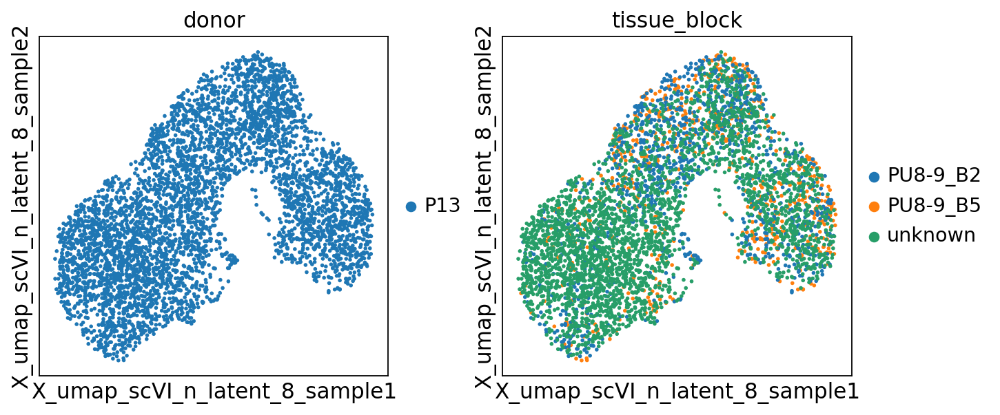

In [58]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','tissue_block'])

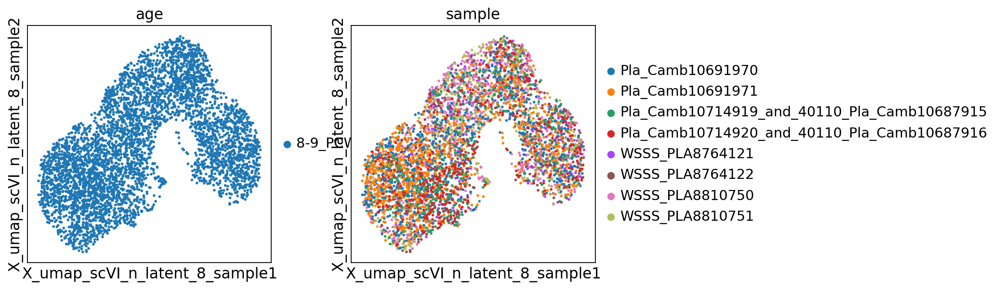

In [59]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['age','sample'])

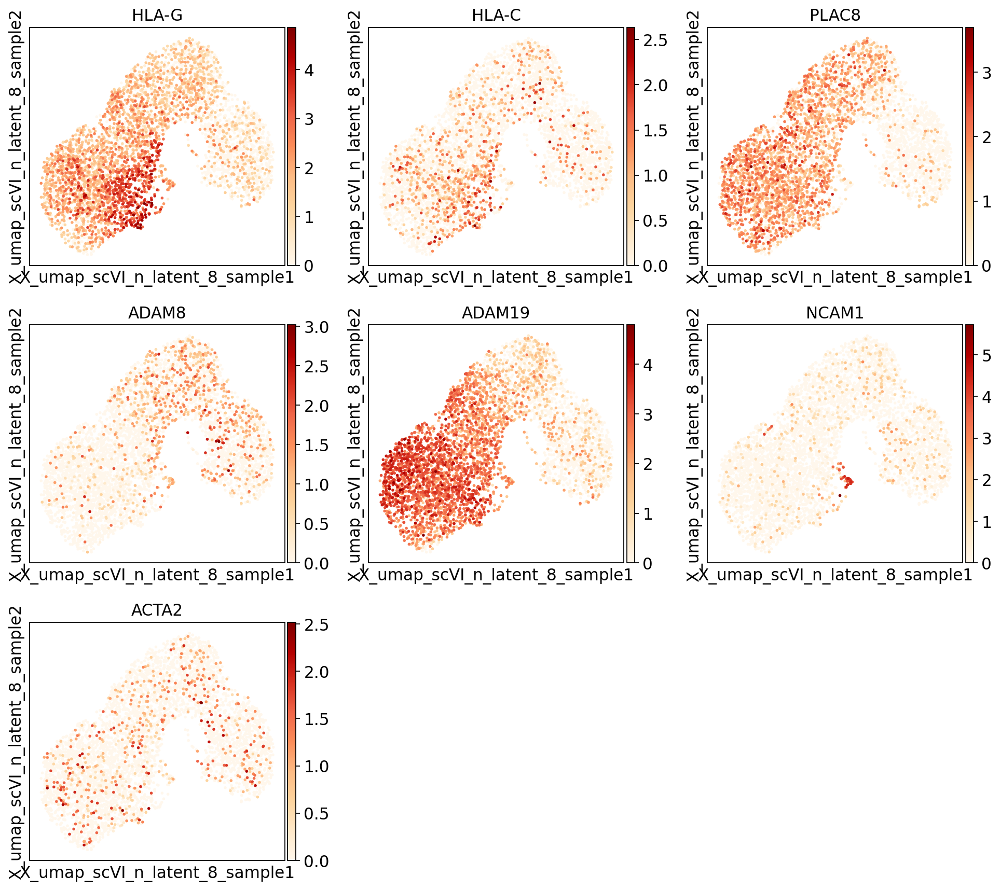

In [60]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

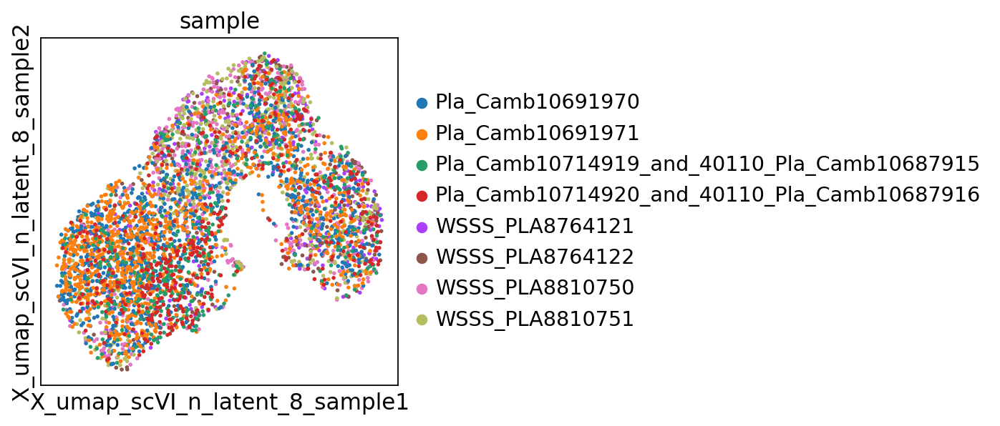

In [61]:
sc.pl.embedding(adata, curr_embedding_key, color=['sample'])

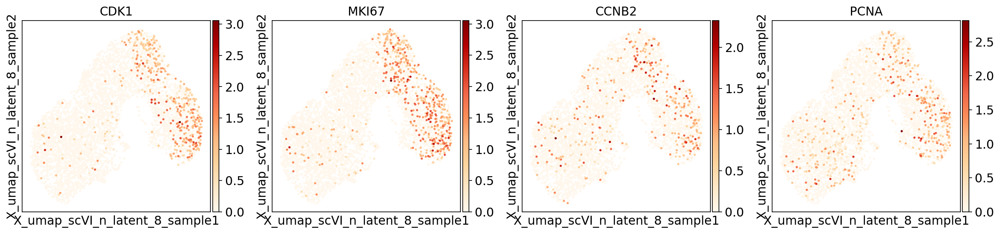

In [62]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [63]:
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'louvain_scvi_n_latent_20', 'louvain_scvi_n_latent_8'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7'
    uns: 'log1p', 'ne

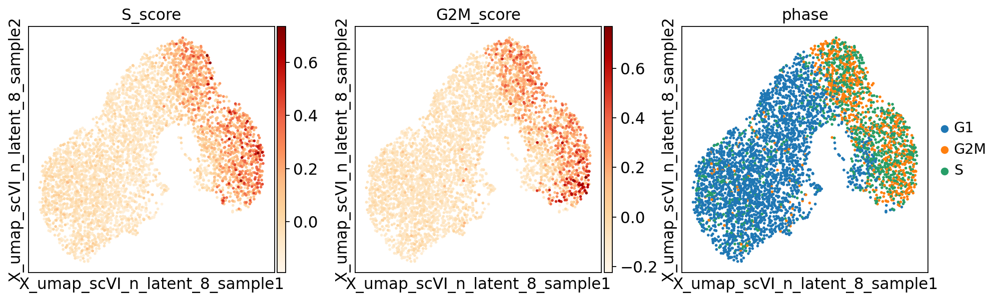

In [64]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [65]:
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'louvain_scvi_n_latent_20', 'louvain_scvi_n_latent_8'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7'
    uns: 'log1p', 'ne

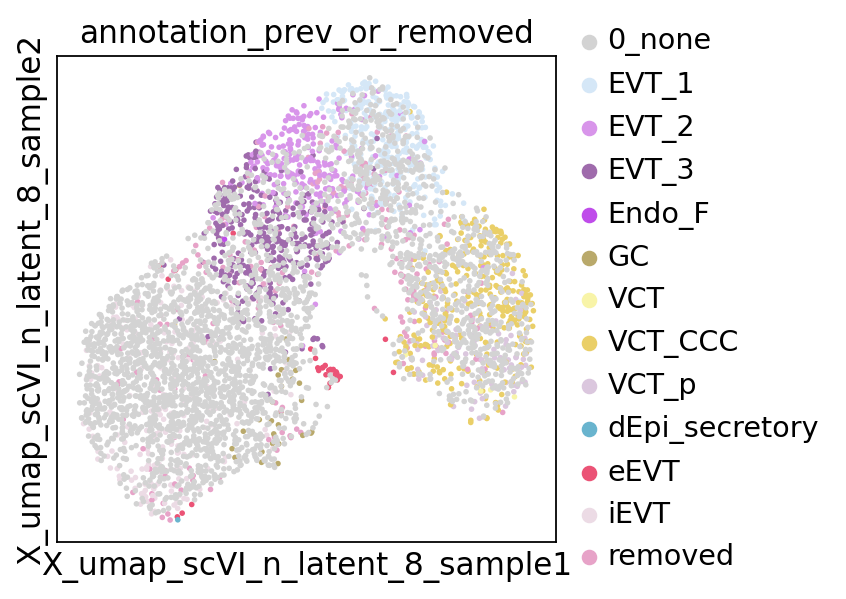

In [66]:
sc.pl.embedding(adata, curr_embedding_key, color=['annotation_prev_or_removed'], palette=palette_new)

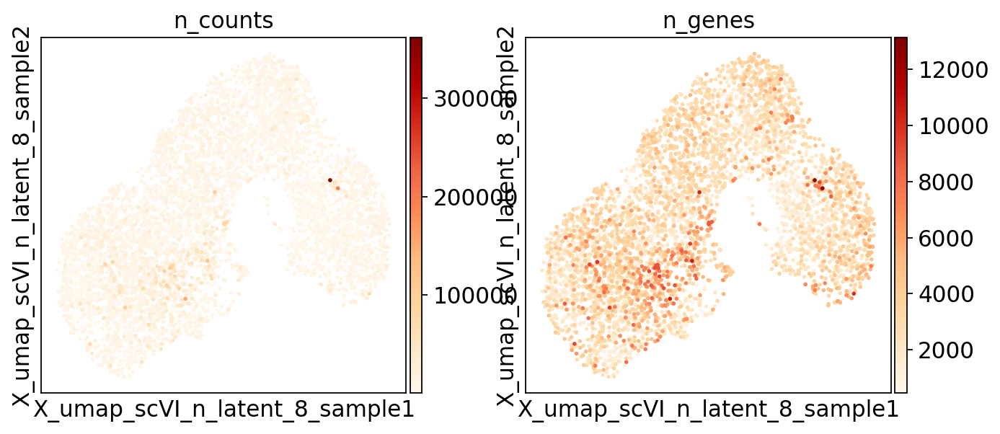

In [67]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

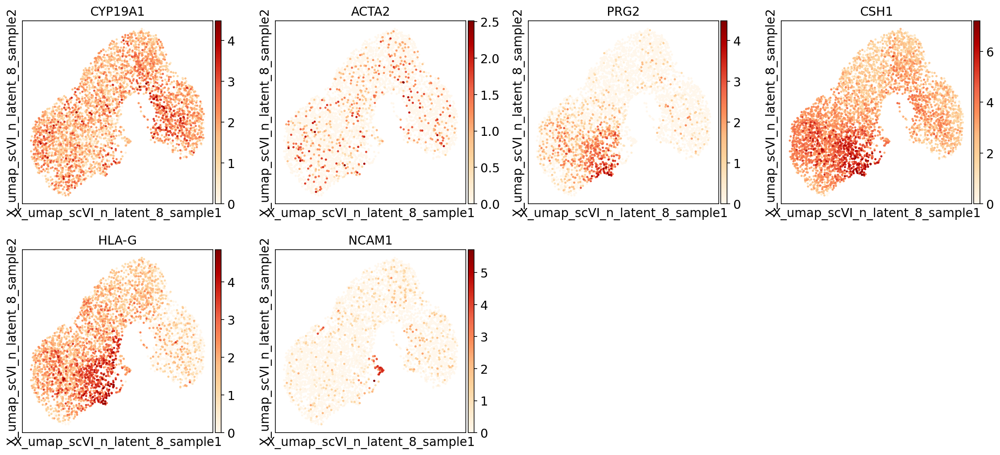

In [68]:
sc.pl.embedding(adata, curr_embedding_key, color=['CYP19A1','ACTA2','PRG2','CSH1','HLA-G',
                                                  'NCAM1'], cmap='OrRd', use_raw=True)

### scVI-corrected by `sample`

n_latent = 20

In [69]:
curr_embedding_key = 'X_umap_scVI_n_latent_20_sample'

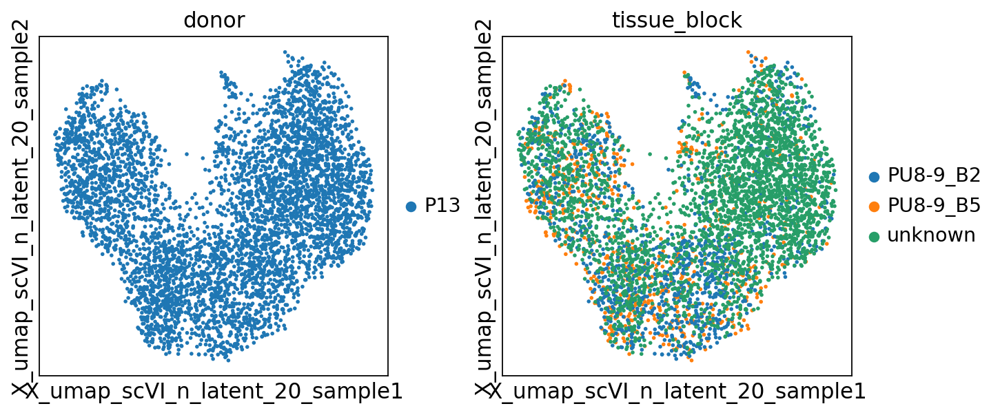

In [70]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','tissue_block'])

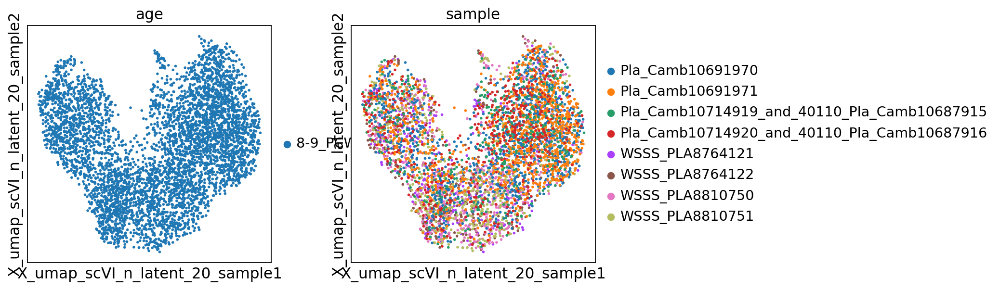

In [71]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['age','sample'])

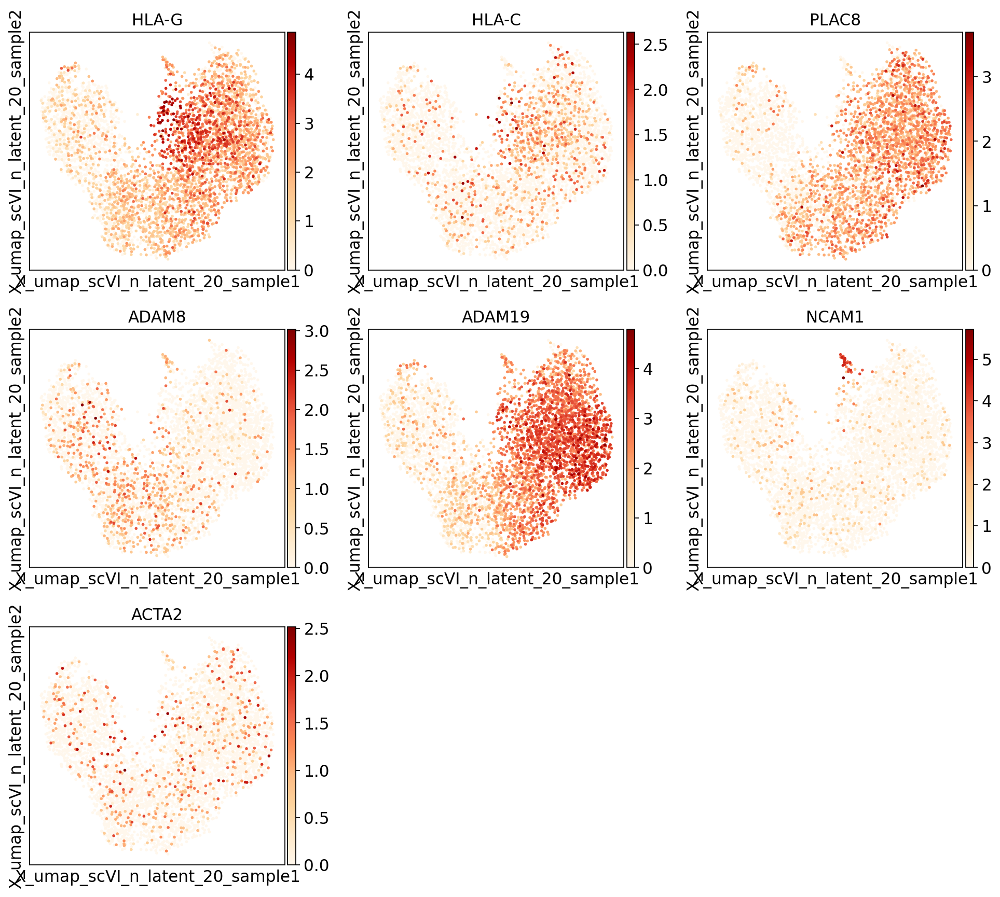

In [72]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

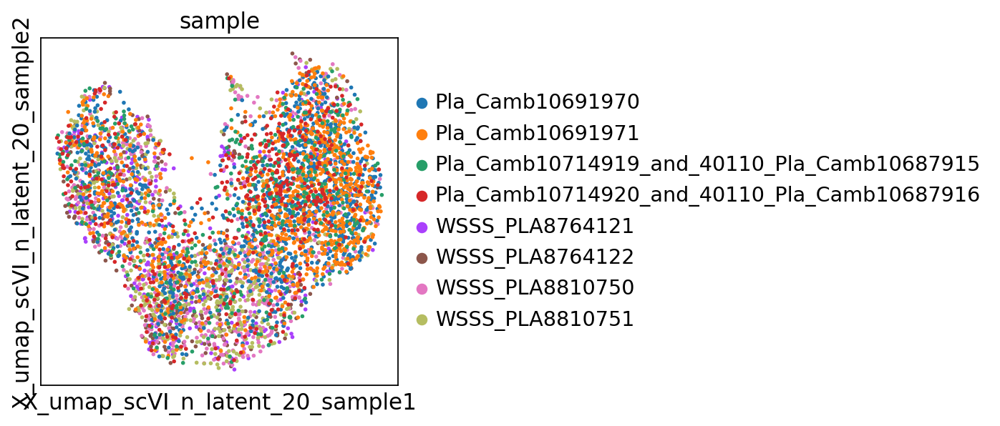

In [73]:
sc.pl.embedding(adata, curr_embedding_key, color=['sample'])

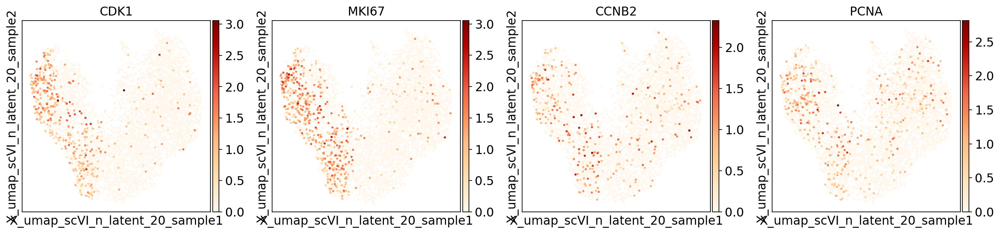

In [74]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [75]:
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'louvain_scvi_n_latent_20', 'louvain_scvi_n_latent_8'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7'
    uns: 'log1p', 'ne

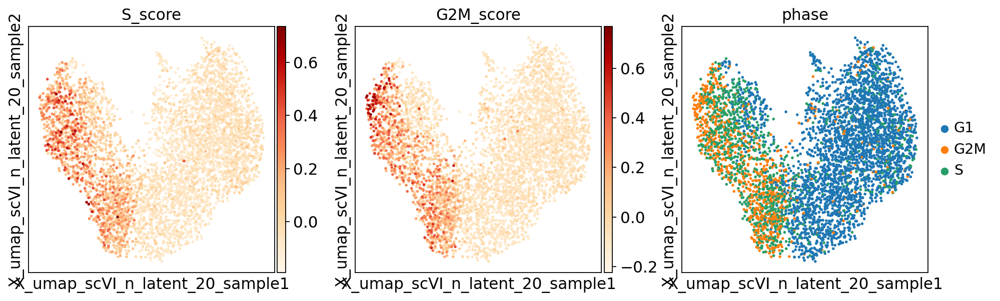

In [76]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [77]:
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'louvain_scvi_n_latent_20', 'louvain_scvi_n_latent_8'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4', 'gene_ids-5', 'feature_types-5', 'genome-5', 'n_cells-5', 'gene_ids-6', 'feature_types-6', 'genome-6', 'n_cells-6', 'gene_ids-7', 'feature_types-7', 'genome-7', 'n_cells-7'
    uns: 'log1p', 'ne

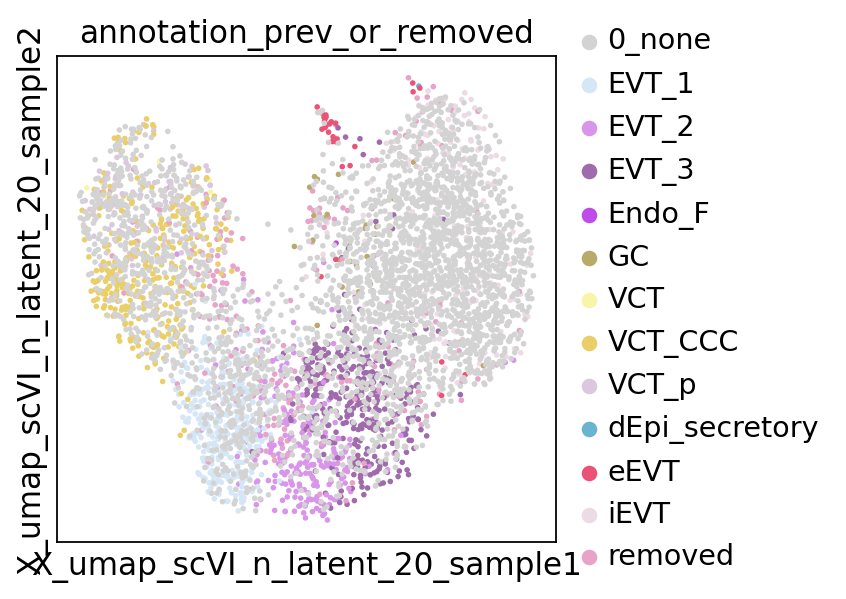

In [78]:
sc.pl.embedding(adata, curr_embedding_key, color=['annotation_prev_or_removed'], palette=palette_new)

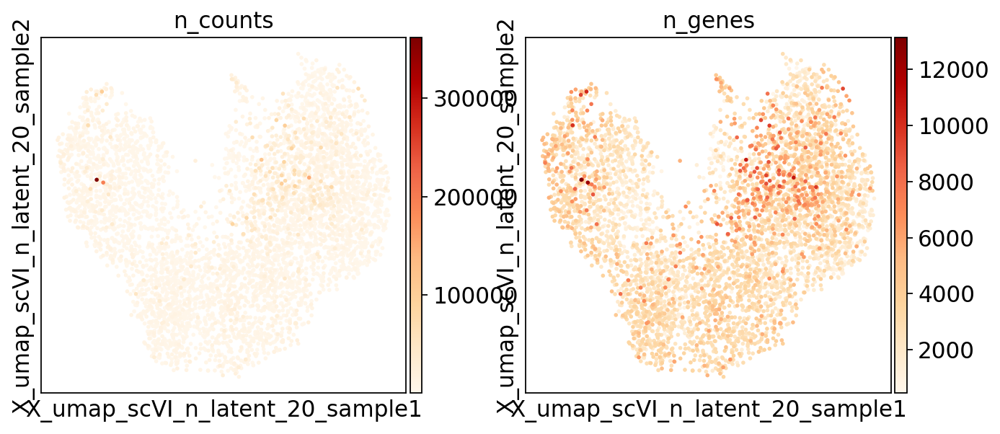

In [79]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

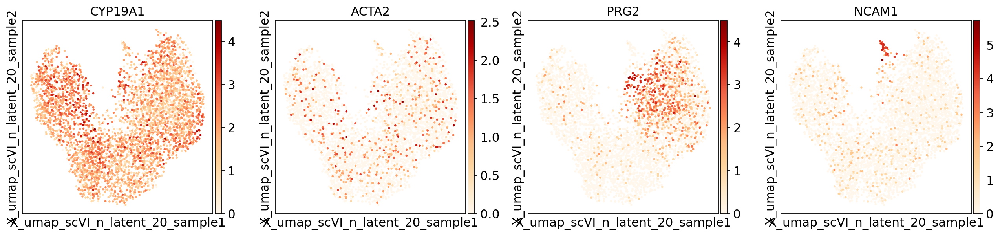

In [80]:
sc.pl.embedding(adata, curr_embedding_key, color=['CYP19A1','ACTA2','PRG2','NCAM1'], cmap='OrRd', use_raw=True)

### scVI-corrected by `sample`

n_latent = 30

In [43]:
curr_embedding_key = 'X_umap_scVI_n_latent_30_sample'

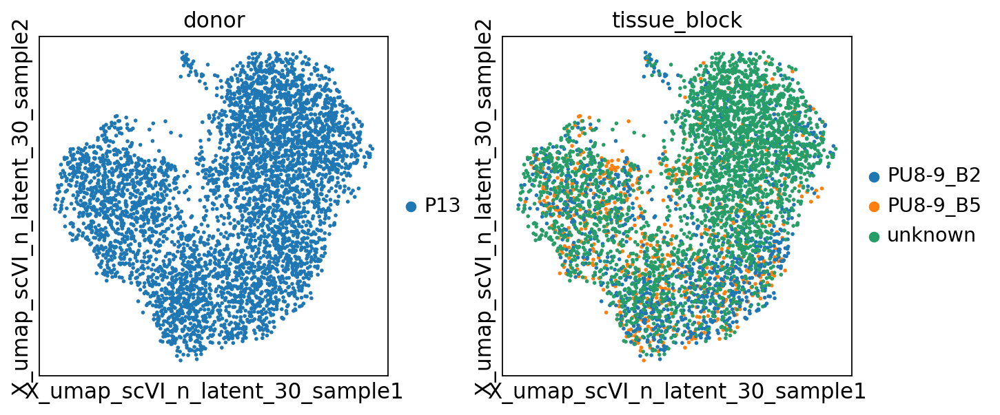

In [44]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','tissue_block'])

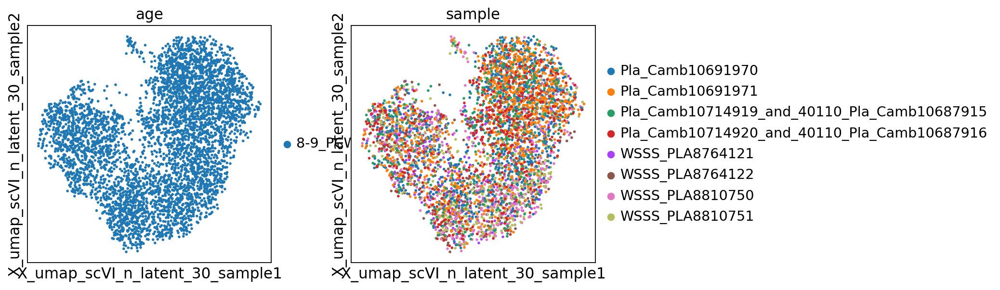

In [45]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['age','sample'])

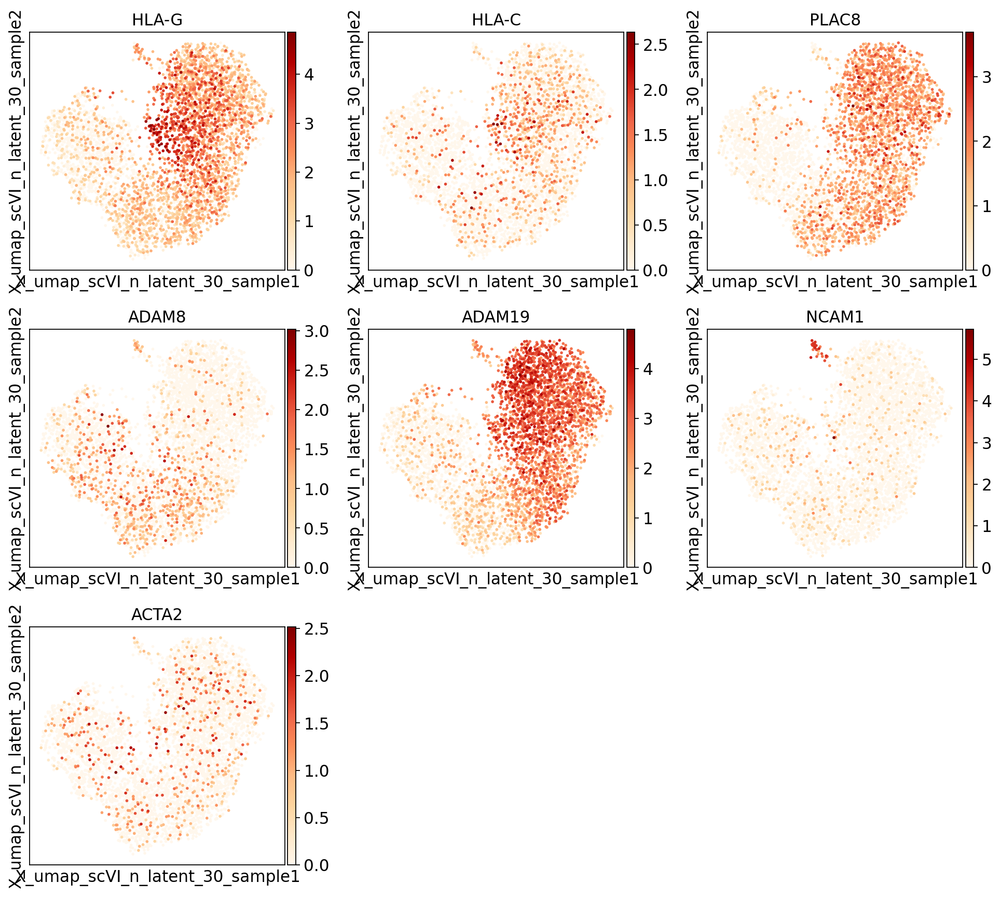

In [46]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['HLA-G','HLA-C','PLAC8',
                             'ADAM8','ADAM19',
                            'NCAM1','ACTA2'], ncols=3, use_raw=True, cmap='OrRd')

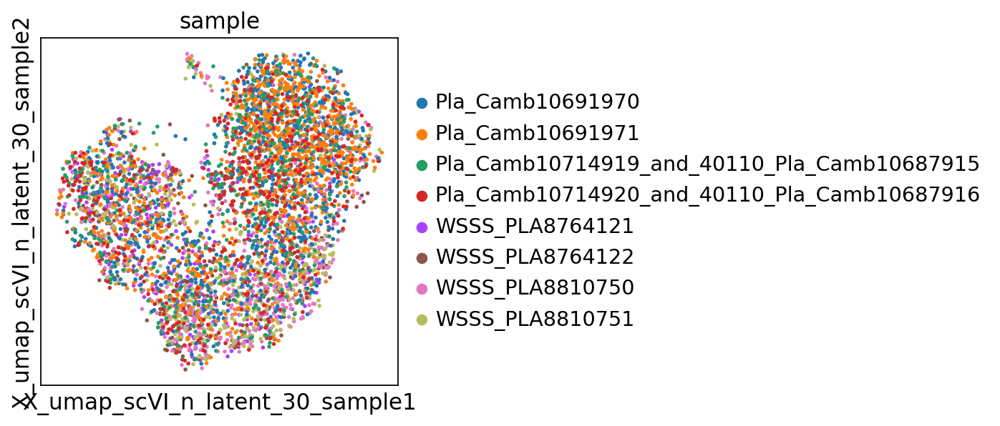

In [47]:
sc.pl.embedding(adata, curr_embedding_key, color=['sample'])

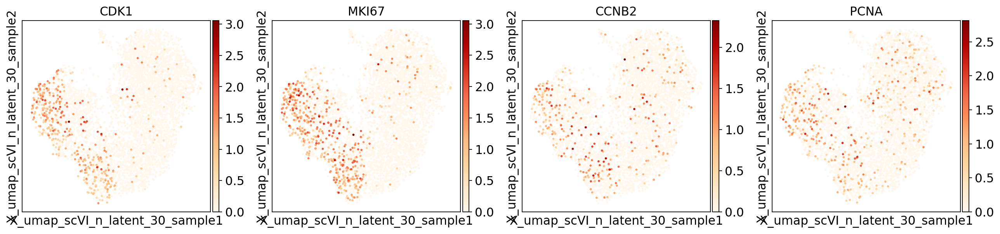

In [48]:
sc.pl.embedding(adata, curr_embedding_key, color=['CDK1','MKI67','CCNB2','PCNA'], cmap='OrRd')

In [49]:
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'louvain_scvi_n_latent_20', 'louvain_scvi_n_latent_8', 'x', 'y', 'z', 'dot_size', 'louvain_scvi_n_latent_20_R', 'annot_inv_troph', 'louvain_scvi_n_latent_8_R', 'louvain_scvi_n_latent_8_RR', 'annot_inv_troph_n_latent_8', 'prelim_annot_scvi_c2l_tested'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4

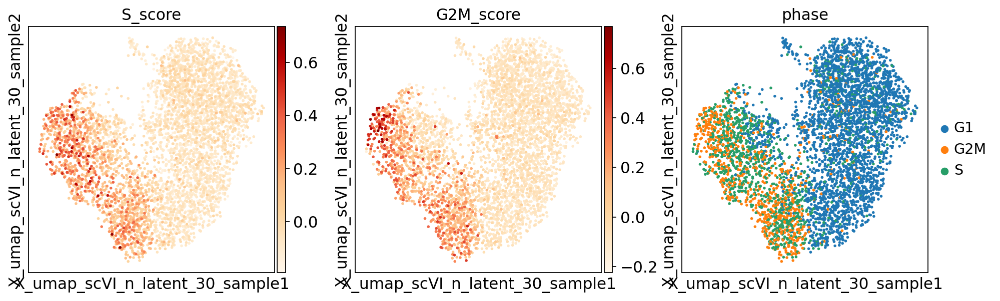

In [50]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [51]:
adata

AnnData object with n_obs × n_vars = 4715 × 29058
    obs: 'n_genes', 'donor', 'tissue_block', 'age', 'sample', 'percent_mito', 'n_counts', 'dataset', 'technique', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'batch', 'is_doublet', 'barcode_sample_copy', 'barcode', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'annotation_prev', 'louvain', 'is_doublet_propagate', 'origin_M_F', 'annotation_prev_or_removed', 'louvain_scvi_n_latent_20', 'louvain_scvi_n_latent_8', 'x', 'y', 'z', 'dot_size', 'louvain_scvi_n_latent_20_R', 'annot_inv_troph', 'louvain_scvi_n_latent_8_R', 'louvain_scvi_n_latent_8_RR', 'annot_inv_troph_n_latent_8', 'prelim_annot_scvi_c2l_tested'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'genome-2', 'n_cells-2', 'gene_ids-3', 'feature_types-3', 'genome-3', 'n_cells-3', 'gene_ids-4', 'feature_types-4', 'genome-4', 'n_cells-4

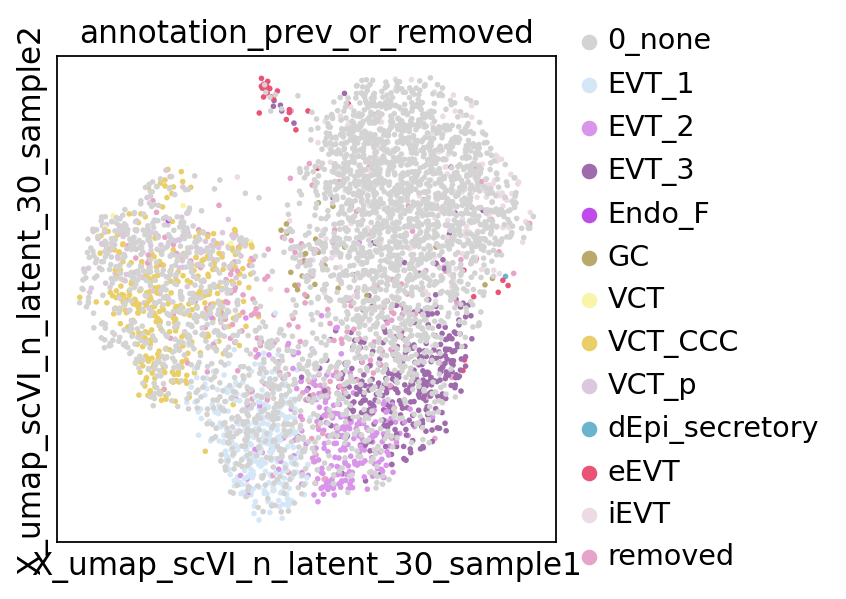

In [52]:
sc.pl.embedding(adata, curr_embedding_key, color=['annotation_prev_or_removed'], palette=palette_new)

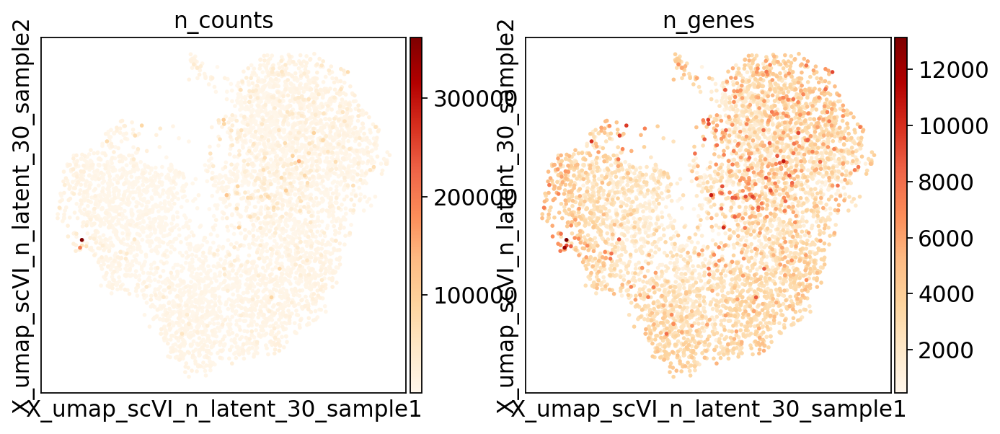

In [53]:
sc.pl.embedding(adata, curr_embedding_key, color=['n_counts',
                             'n_genes'], cmap='OrRd')

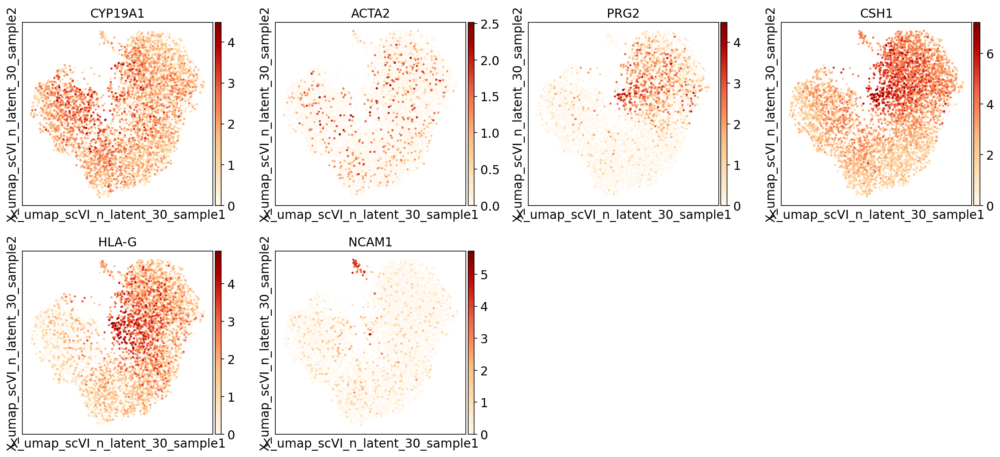

In [54]:
sc.pl.embedding(adata, curr_embedding_key, color=['CYP19A1','ACTA2','PRG2','CSH1','HLA-G',
                                                  'NCAM1'], cmap='OrRd', use_raw=True)

In [95]:
# using object with 30 latent variables here
curr_embedding_key = 'X_umap_scVI_n_latent_30_sample'

In [96]:
# cluster apart invading troph from VCT_CCC onwards
sc.tl.louvain(adata, resolution=1.0,
             neighbors_key = 'neighbors_scVI_n_latent_30_sample',
             key_added = 'louvain_scvi_n_latent_30')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 7 clusters and added
    'louvain_scvi_n_latent_30', the cluster labels (adata.obs, categorical) (0:00:00)


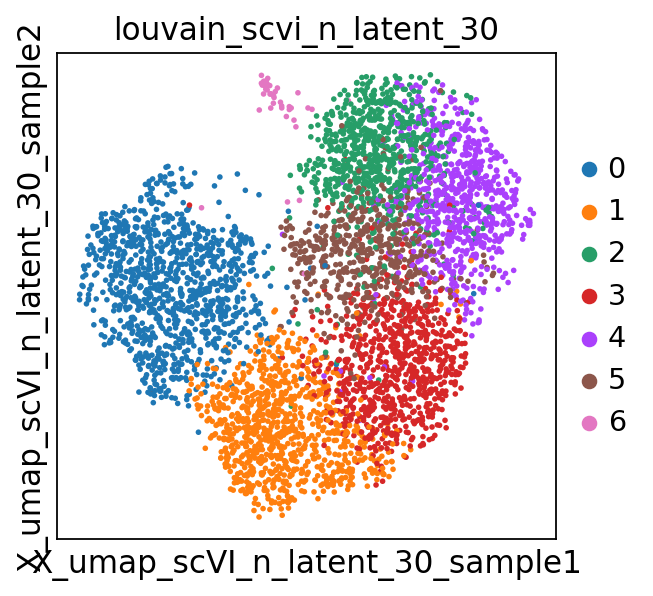

In [97]:
sc.pl.embedding(adata, curr_embedding_key, color='louvain_scvi_n_latent_30')

In [103]:
# cluster apart GC a bit more as PRG2++
sc.tl.louvain(adata, resolution=1.0,
              restrict_to=('louvain_scvi_n_latent_30',['5']),
             neighbors_key = 'neighbors_scVI_n_latent_30_sample',
             key_added = 'louvain_scvi_n_latent_30_R')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 13 clusters and added
    'louvain_scvi_n_latent_30_R', the cluster labels (adata.obs, categorical) (0:00:00)


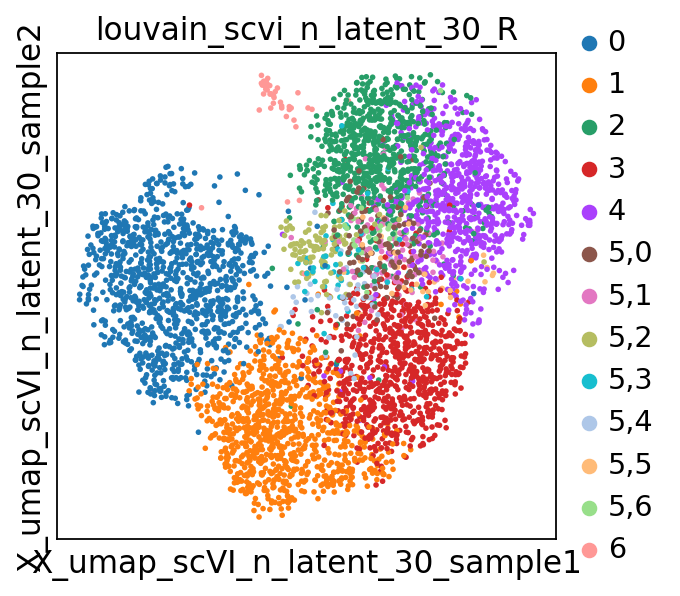

In [104]:
sc.pl.embedding(adata, curr_embedding_key, color='louvain_scvi_n_latent_30_R', 
                #legend_loc='on data'
               )

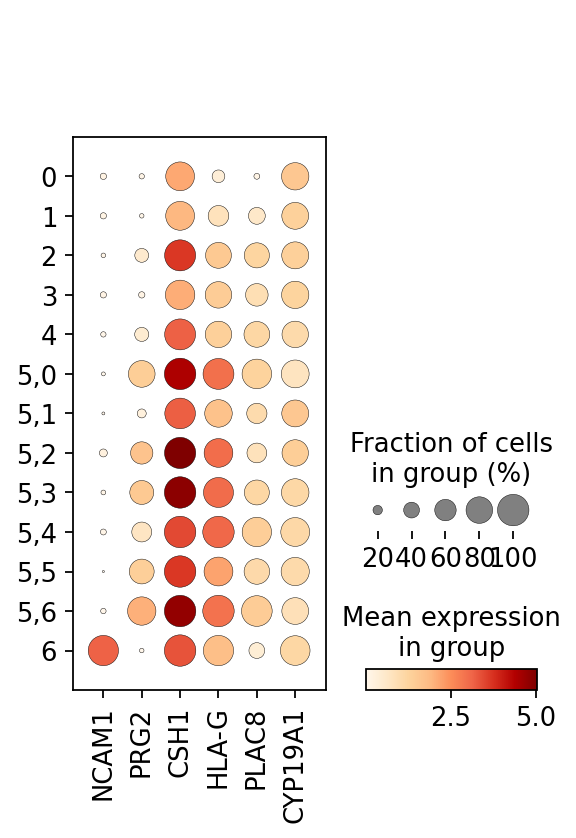

In [105]:
sc.pl.dotplot(adata, var_names = ['NCAM1','PRG2','CSH1','HLA-G',
                                  'PLAC8','CYP19A1',
                                 ], cmap='OrRd', use_raw=True,
             groupby = 'louvain_scvi_n_latent_30_R')

In [106]:
# here 5,2 may be GCs
# eEVT are 6

In [107]:
# annotation within n_latent = 8 manifold


In [108]:
# annotation - may change depending on cell2location mappings
def annot_inv_troph_n_latent_30(adata_obj, barcode):
    curr_louvain = adata_obj.obs.loc[barcode,'louvain_scvi_n_latent_30_R']
    
    if curr_louvain == '5,2':
        return('GC')
    elif curr_louvain == '0':
        return('VCT_CCC')
    elif curr_louvain == '1':
        return('EVT_1')
    elif curr_louvain == '3':
        return('EVT_2')
    elif curr_louvain in ['2','4','5,0','5,1','5,3','5,4','5,5','5,6']:
        return('iEVT')
    elif curr_louvain == '6':
        return('eEVT')
    
    else:
        return('none')

In [109]:
adata.obs['annot_inv_troph_n_latent_30'] = adata.obs['barcode_sample_copy'].apply(lambda x: annot_inv_troph_n_latent_30(adata,x))

... storing 'annot_inv_troph_n_latent_30' as categorical


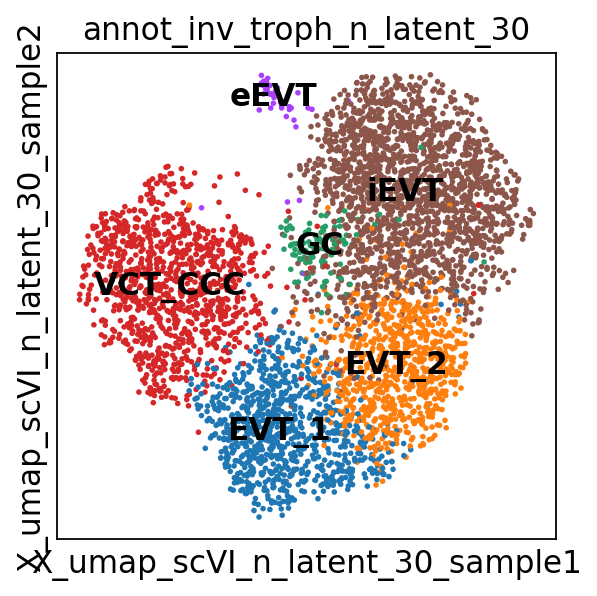

In [110]:
sc.pl.embedding(adata, curr_embedding_key, color='annot_inv_troph_n_latent_30', legend_loc='on data')

In [ ]:
# trying to zoom into what is now iEVT and GC?...

In [111]:
# update saved object 
adata.write(save_path + 'adata_P13_scVI_analysed_corr_by_sample_SN_and_multiome_invading_trophoblast_cleanup_v2.h5ad')


# using object with 8 latent vars since it's reflecting eEVT and GC better

In [12]:
# using object with 8 latent variables here
curr_embedding_key = 'X_umap_scVI_n_latent_8_sample'

In [13]:
# cluster apart invading troph from VCT_CCC onwards
sc.tl.louvain(adata, resolution=1.0,
             neighbors_key = 'neighbors_scVI_n_latent_8_sample',
             key_added = 'louvain_scvi_n_latent_8')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 11 clusters and added
    'louvain_scvi_n_latent_8', the cluster labels (adata.obs, categorical) (0:00:00)


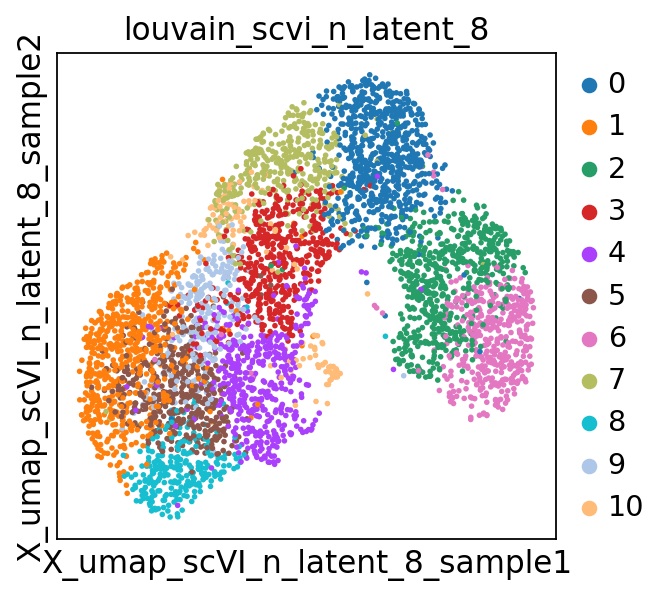

In [14]:
sc.pl.embedding(adata, curr_embedding_key, color='louvain_scvi_n_latent_8')

In [15]:
# cluster apart GC a bit more as PRG2++
sc.tl.louvain(adata, resolution=0.2,
              restrict_to=('louvain_scvi_n_latent_8',['4']),
             neighbors_key = 'neighbors_scVI_n_latent_8_sample',
             key_added = 'louvain_scvi_n_latent_8_R')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 13 clusters and added
    'louvain_scvi_n_latent_8_R', the cluster labels (adata.obs, categorical) (0:00:00)


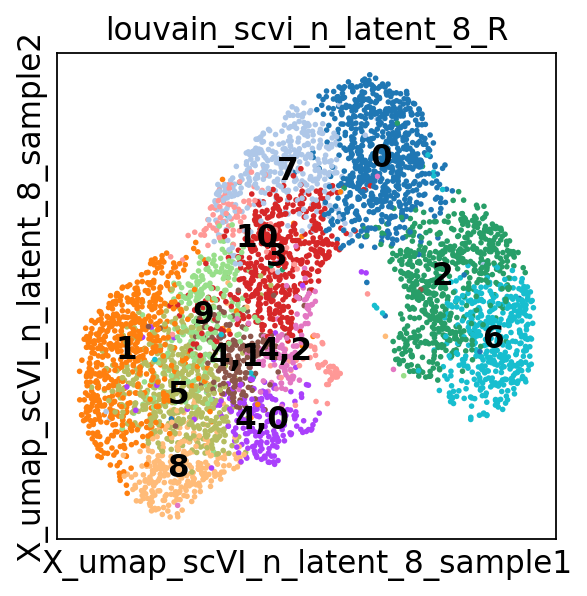

In [16]:
sc.pl.embedding(adata, curr_embedding_key, color='louvain_scvi_n_latent_8_R', legend_loc='on data')

In [17]:
# separate eEVT a bit better
sc.tl.louvain(adata, resolution=0.2,
              restrict_to=('louvain_scvi_n_latent_8_R',['10']),
             neighbors_key = 'neighbors_scVI_n_latent_8_sample',
             key_added = 'louvain_scvi_n_latent_8_RR')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 14 clusters and added
    'louvain_scvi_n_latent_8_RR', the cluster labels (adata.obs, categorical) (0:00:00)


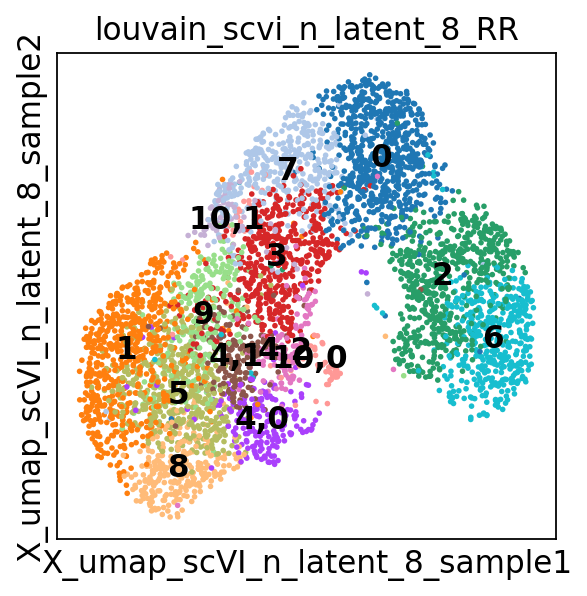

In [18]:
sc.pl.embedding(adata, curr_embedding_key, color='louvain_scvi_n_latent_8_RR', 
                legend_loc='on data',
               )

In [ ]:
# here 4,0 may be GCs
# eEVT are 10,0

In [ ]:
# annotation within n_latent = 8 manifold


In [165]:
# annotation - may change depending on cell2location mappings
def annot_inv_troph_n_latent_8(adata_obj, barcode):
    curr_louvain = adata_obj.obs.loc[barcode,'louvain_scvi_n_latent_8_RR']
    
    if curr_louvain == '4,0':
        return('GC')
    elif curr_louvain in ['2','6']:
        return('VCT_CCC')
    elif curr_louvain == '0':
        return('EVT_1')
    elif curr_louvain in ['3','7','10,1']:
        return('EVT_2')
    elif curr_louvain in ['4,1','4,2','1','5','8','9']:
        return('iEVT')
    elif curr_louvain == '10,0':
        return('eEVT')
    
    else:
        return('none')

In [166]:
adata.obs['annot_inv_troph_n_latent_8'] = adata.obs['barcode_sample_copy'].apply(lambda x: annot_inv_troph_n_latent_8(adata,x))

... storing 'annot_inv_troph_n_latent_8' as categorical


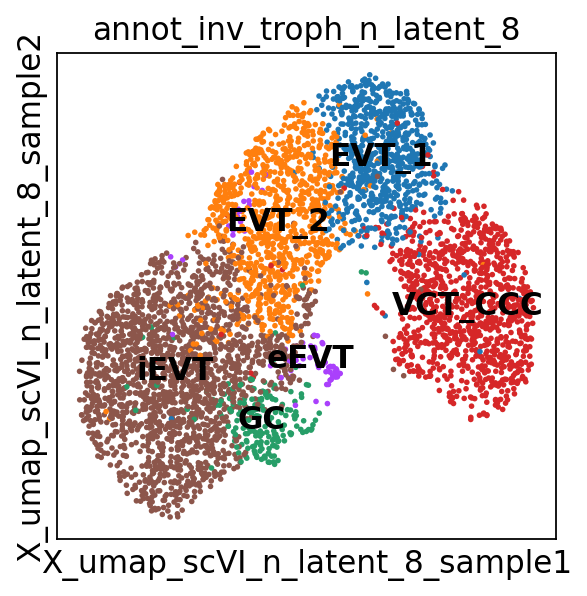

In [167]:
sc.pl.embedding(adata, curr_embedding_key, color='annot_inv_troph_n_latent_8', legend_loc='on data')

### 23.11.2021: trying to annotate GC and eEVT more precisely after going back and forth with cell2location locating these cell states in Visium data


In [23]:
# cluster apart invading troph from VCT_CCC onwards
sc.tl.louvain(adata, resolution=1.0,
             neighbors_key = 'neighbors_scVI_n_latent_8_sample',
             key_added = 'louvain_scvi_n_latent_8')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 11 clusters and added
    'louvain_scvi_n_latent_8', the cluster labels (adata.obs, categorical) (0:00:00)


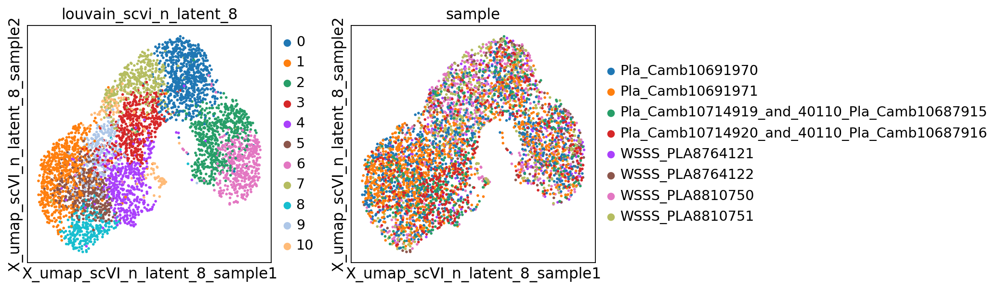

In [25]:
sc.pl.embedding(adata, curr_embedding_key, color=['louvain_scvi_n_latent_8','sample'])

In [38]:
# cluster apart GC a bit more as PRG2++
sc.tl.louvain(adata, resolution=0.7,
              restrict_to=('louvain_scvi_n_latent_8',['4']),
             neighbors_key = 'neighbors_scVI_n_latent_8_sample',
             key_added = 'louvain_scvi_n_latent_8_R')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 17 clusters and added
    'louvain_scvi_n_latent_8_R', the cluster labels (adata.obs, categorical) (0:00:00)


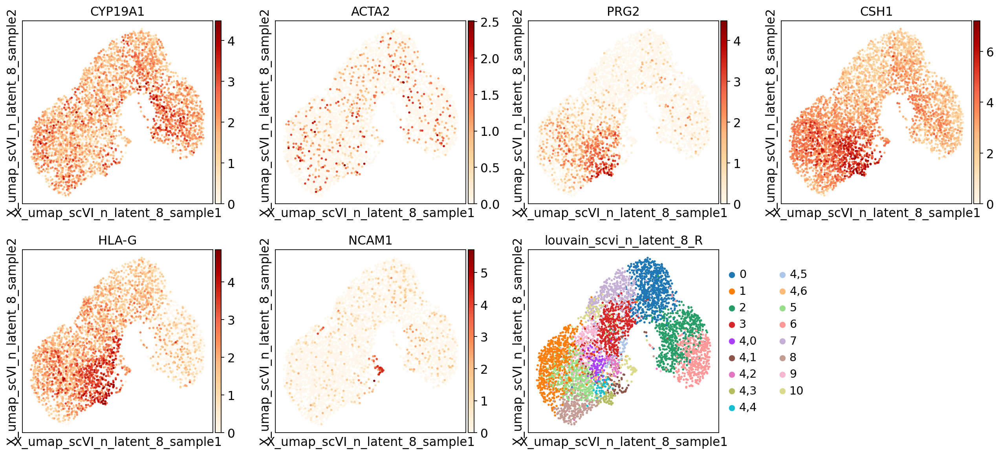

In [39]:
sc.pl.embedding(adata, curr_embedding_key, color=['CYP19A1','ACTA2','PRG2','CSH1','HLA-G',
                                                  'NCAM1','louvain_scvi_n_latent_8_R'], cmap='OrRd', use_raw=True)


In [63]:
# separate eEVT a bit better
sc.tl.louvain(adata, resolution=0.2,
              restrict_to=('louvain_scvi_n_latent_8_R',['10']),
             neighbors_key = 'neighbors_scVI_n_latent_8_sample',
             key_added = 'louvain_scvi_n_latent_8_RR')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 18 clusters and added
    'louvain_scvi_n_latent_8_RR', the cluster labels (adata.obs, categorical) (0:00:00)


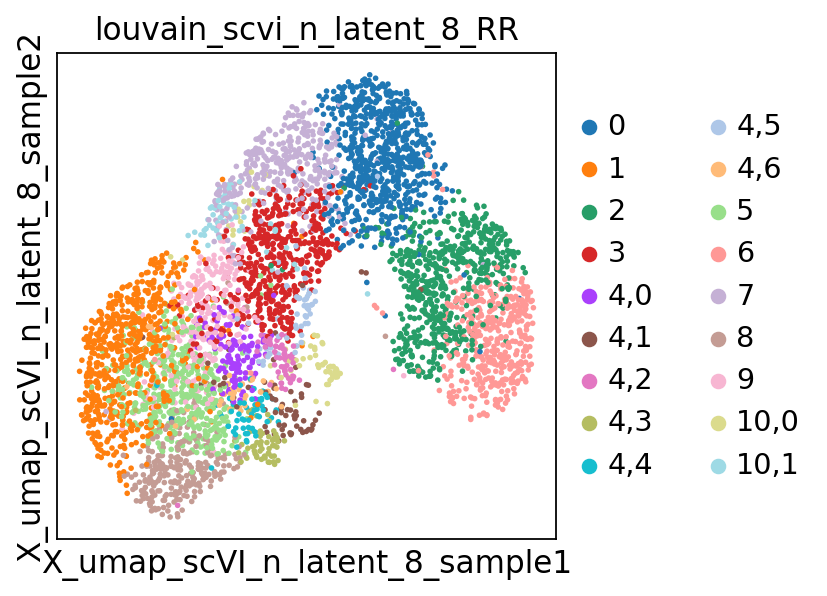

In [64]:
sc.pl.embedding(adata, curr_embedding_key, color='louvain_scvi_n_latent_8_RR', 
                #legend_loc='on data',
               )

In [66]:
# how many GCs?
len(adata[adata.obs['louvain_scvi_n_latent_8_RR'] == '4,3'])

58

In [67]:
adata[adata.obs['louvain_scvi_n_latent_8_RR'] == '4,3'].obs['sample'].value_counts()

Pla_Camb10714919_and_40110_Pla_Camb10687915    23
Pla_Camb10714920_and_40110_Pla_Camb10687916    13
Pla_Camb10691971                                8
Pla_Camb10691970                                6
WSSS_PLA8764122                                 4
WSSS_PLA8810750                                 2
WSSS_PLA8764121                                 1
WSSS_PLA8810751                                 1
Name: sample, dtype: int64

In [69]:
# how many eEVTs?
len(adata[adata.obs['louvain_scvi_n_latent_8_RR'] == '10,0'])

71

In [70]:
adata[adata.obs['louvain_scvi_n_latent_8_RR'] == '10,0'].obs['sample'].value_counts()

WSSS_PLA8810750                                18
WSSS_PLA8764122                                12
WSSS_PLA8810751                                12
Pla_Camb10691971                                9
Pla_Camb10691970                                6
Pla_Camb10714919_and_40110_Pla_Camb10687915     5
WSSS_PLA8764121                                 5
Pla_Camb10714920_and_40110_Pla_Camb10687916     4
Name: sample, dtype: int64

In [71]:
# here 4,3 are GCs
# eEVT are 10,0

In [72]:
# annotation within n_latent = 8 manifold
# corrected (23.11.2021)

In [73]:
# annotation - may change depending on cell2location mappings
def annot_inv_troph_n_latent_8_corrected(adata_obj, barcode):
    curr_louvain = adata_obj.obs.loc[barcode,'louvain_scvi_n_latent_8_RR']
    
    if curr_louvain == '4,3':
        return('GC')
    elif curr_louvain in ['2','6']:
        return('VCT_CCC')
    elif curr_louvain == '0':
        return('EVT_1')
    elif curr_louvain in ['3','7','4,5']:
        return('EVT_2')
    elif curr_louvain in ['4,0','4,1','4,2','4,4','4,6','1','5','8','9','10,1']:
        return('iEVT')
    elif curr_louvain == '10,0':
        return('eEVT')
    
    else:
        return('none')

In [74]:
adata.obs['annot_inv_troph_n_latent_8_corrected'] = adata.obs['barcode_sample_copy'].apply(lambda x: annot_inv_troph_n_latent_8_corrected(adata,x))

... storing 'annot_inv_troph_n_latent_8_corrected' as categorical


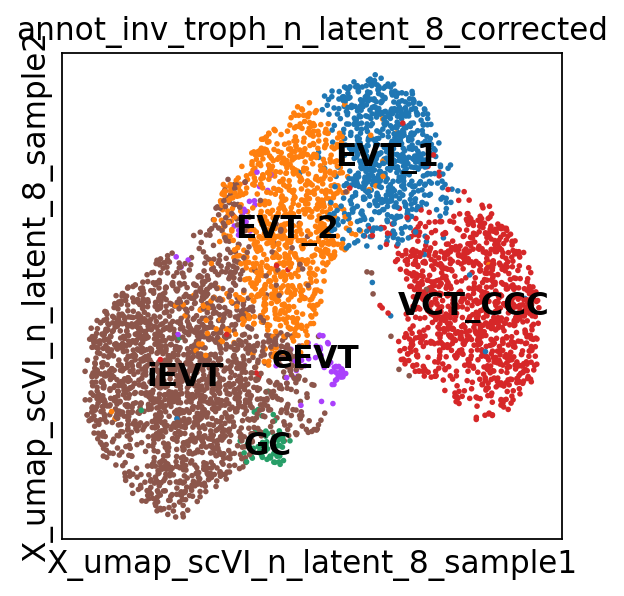

In [75]:
sc.pl.embedding(adata, curr_embedding_key, color='annot_inv_troph_n_latent_8_corrected', legend_loc='on data')

### this is the very final annotation of invading troph states

In [76]:
# update saved file
adata.write(save_path + 'adata_P13_scVI_analysed_corr_by_sample_SN_and_multiome_invading_trophoblast_cleanup_v2.h5ad')


In [77]:
adata.obs.to_csv(save_path + 'annotations_SN_and_multiome_inv_troph_cleanup_v2_final_20211123.csv')

From here following to notebook S5-5